## Image contrast

In [233]:
import numpy as np
from skimage import io, exposure, measure, morphology
from stardist.plot import render_label
from csbdeep.utils import normalize
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from skimage.filters import gaussian, median
import pandas as pd
from stardist.models import StarDist2D 
import time
import scipy
rng = np.random.default_rng(2021)

In [234]:
# prints a list of available models 
StarDist2D.from_pretrained() 

# creates a pretrained model
model = StarDist2D.from_pretrained('2D_versatile_fluo')

There are 4 registered models for 'StarDist2D':

Name                  Alias(es)
────                  ─────────
'2D_versatile_fluo'   'Versatile (fluorescent nuclei)'
'2D_versatile_he'     'Versatile (H&E nuclei)'
'2D_paper_dsb2018'    'DSB 2018 (from StarDist 2D paper)'
'2D_demo'             None
Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.


Plotting function with optional zoom area:

In [235]:
def plot_pred_overlay(img, labels, zoom=False):
    '''Plots image and predicted labels

    :param img: 2D image
    :type img: ndarray
    :param labels: color-labels of pixels in img
    :type labels: ndarray
    :param zoom: [x1, y1, x2, y2], area of img where you want to zoom in
    :rtype zoom: list, opt

    '''

    if zoom:
        x1, y1, x2, y2 = zoom
    else:
        x1, y1 = [0, 0]
        x2, y2 = img.shape

        
    num_cells = len(measure.regionprops(labels))
    
    fig = plt.figure(figsize=(24, 24))

    plt.subplot(2,2,1)

    plt.imshow(img, cmap='gray')
    plt.axis("off")
    plt.title("input image")

    plt.subplot(2,2,2)
    plt.imshow(render_label(labels, img=img))
    plt.axis("off")
    plt.title(str(num_cells) + 'predicted cells')
    
    
    plt.subplot(2, 2, 3)
    plt.imshow(img[x1:x2, y1:y2], cmap='gray')
    plt.axis("off")
    plt.title("input image, zoomed")

    plt.subplot(2, 2, 4)
    plt.imshow(render_label(labels[x1:x2, y1:y2], img=img[x1:x2, y1:y2]))
    plt.axis("off")
    plt.title("prediction + input overlay")

    plt.savefig('')
    plt.show()
    return fig

#### Load image

In [236]:
img = io.imread('../data/raw/0104_p301s_nissl.jpg') 
img_gray = rgb2gray(img)

#### Check out the intensity distribution:

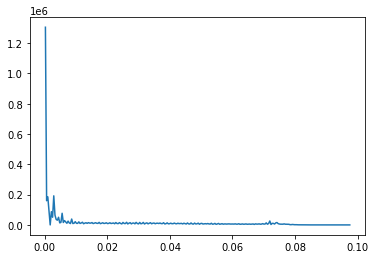

In [238]:
hist = exposure.histogram(img_gray)
heights, intensities = hist
# plt.bar(intensities, heights)
plt.plot(intensities, heights)

The stardist model gives both labels and details.
Show prediction:

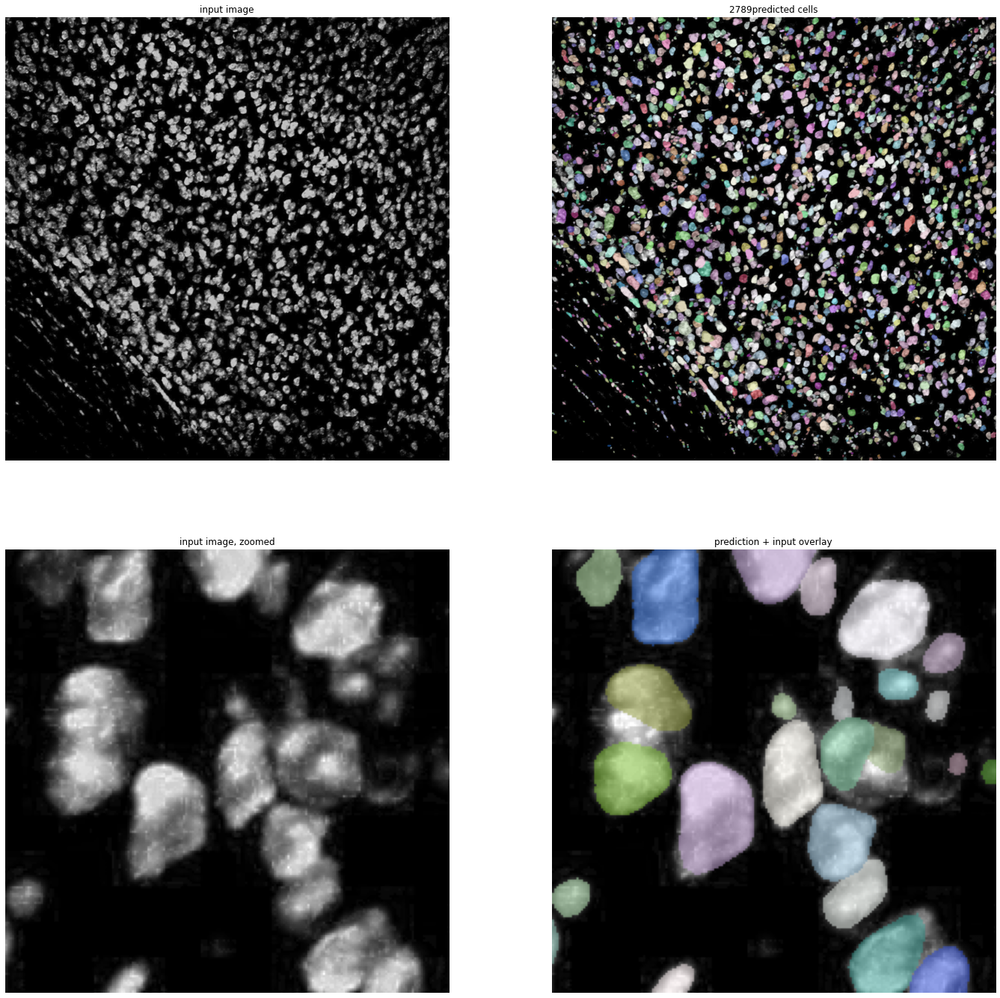

In [135]:
labels, details = model.predict_instances(normalize(img_gray))
zoom_area = [1000, 1000, 1200, 1200]
fig = plot_pred_overlay(img_gray, labels, zoom=zoom_area)

Check out details

In [7]:
details.keys()

dict_keys(['coord', 'points', 'prob'])

Seems like a good idea to
- increase contrast
- remove too small cells
- remove too long cells

In this notebook: Check out rescaling - changing contrast

In [240]:
import numpy as np
# compute the 0.5% and 99% percentiles for the intensities in img_gray:
percentiles = np.percentile(img_gray, (0.5, 99))
print(percentiles)

[0.         0.07627529]


In [9]:
img_scaled = exposure.rescale_intensity(img_gray, in_range=tuple(percentiles))

[]

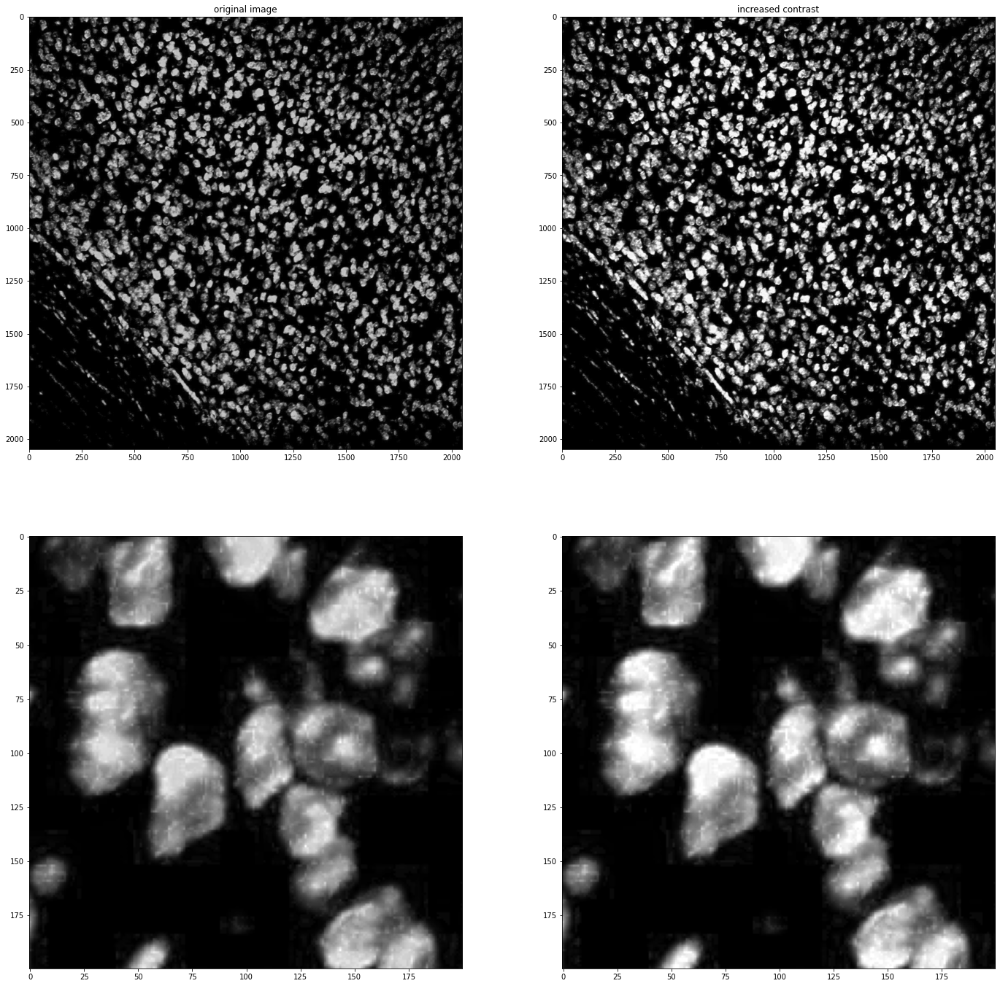

In [10]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(24,24))
axes = np.concatenate(axes, axis=0)
axes[0].imshow(img_gray, cmap='gray')
axes[0].set_title('original image')
axes[1].imshow(img_scaled, cmap='gray')
axes[1].set_title('increased contrast')
axes[2].imshow(img_gray[1000:1200, 1000:1200], cmap='gray')
axes[3].imshow(img_scaled[1000:1200, 1000:1200], cmap='gray')

plt.plot()

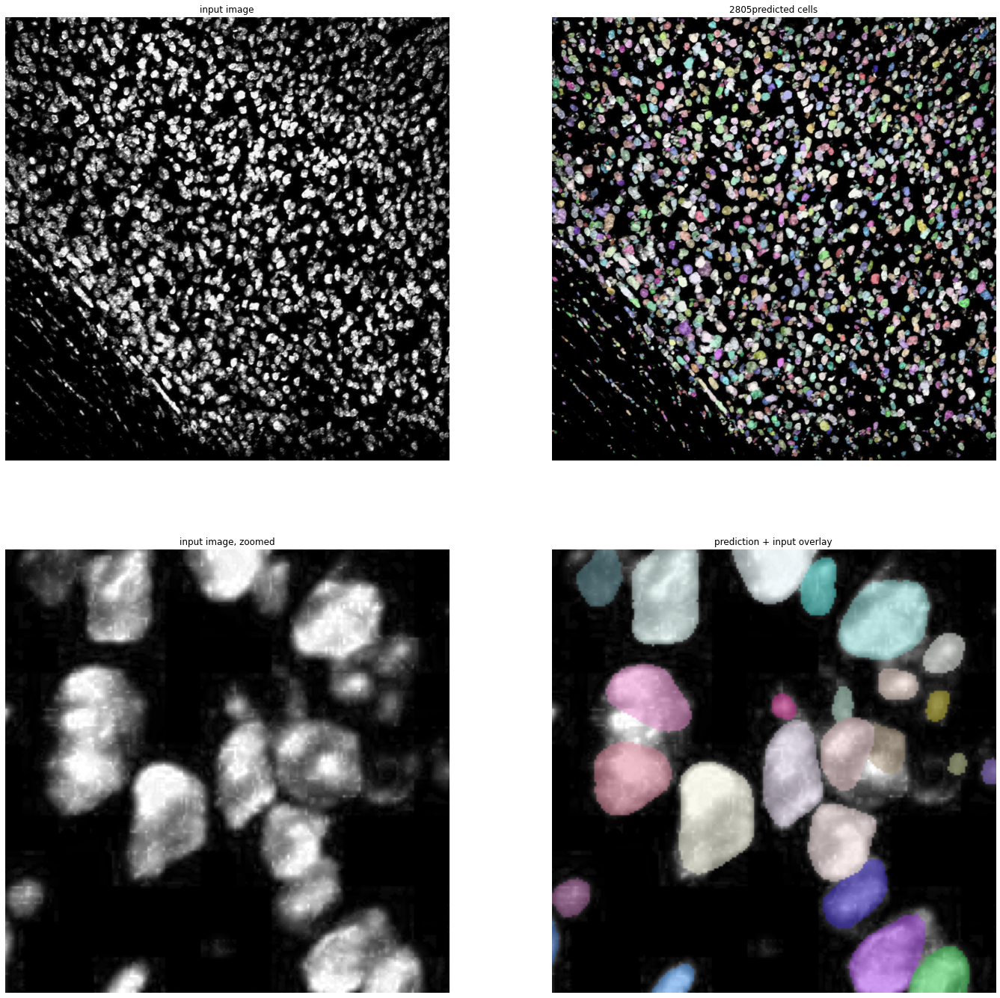

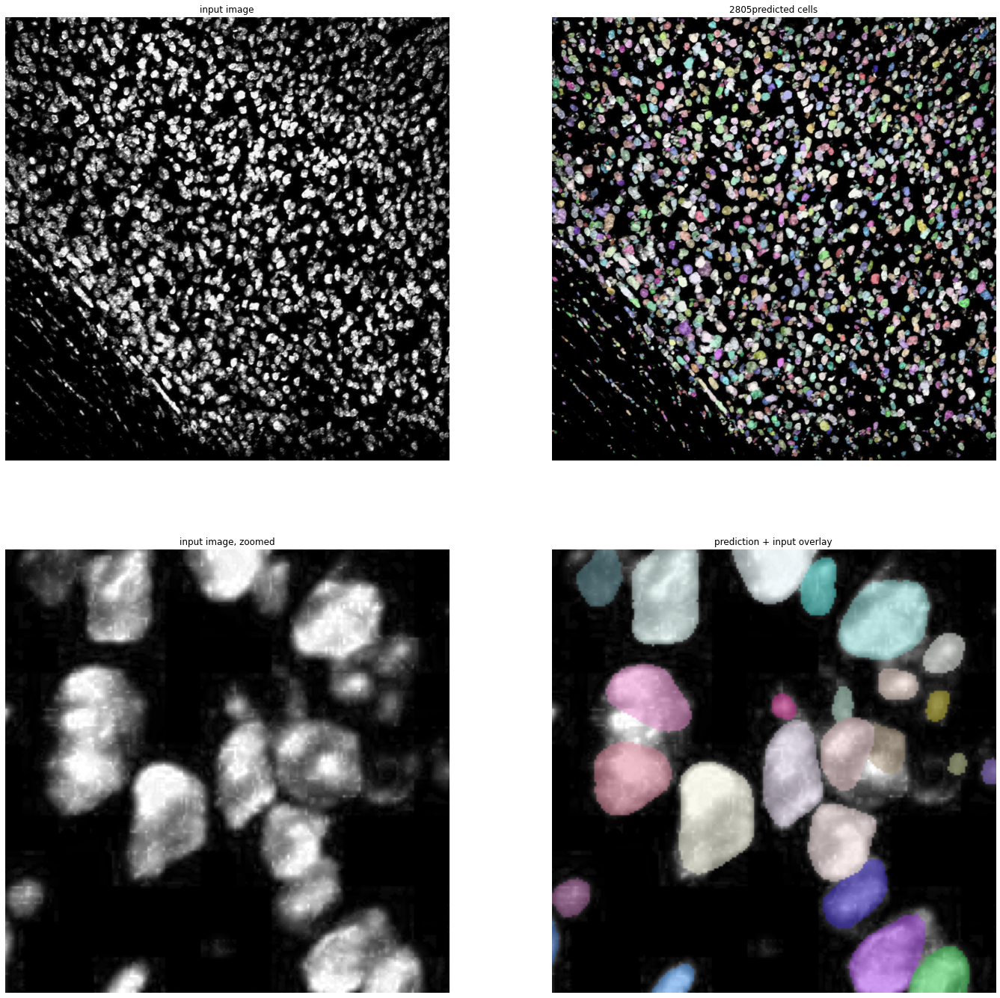

In [11]:
labels_scaled, _ = model.predict_instances(normalize(img_scaled),
                                           )
zoom_area = [1000, 1000, 1200, 1200]
plot_pred_overlay(img_scaled, labels_scaled, zoom=zoom_area)

Count cells

In [12]:
num_cells = len(measure.regionprops(labels))
print(num_cells)

2789


Doesn't seem like the contrast increase changed the outcome.

Now, try to find out whether tweaking prob_thresh or nms_thresh will improve the results.
- large nms_thresh: cells with large overlap will be counted as one.
- large prob_thresh: cells with low probability will not be defined as cells.

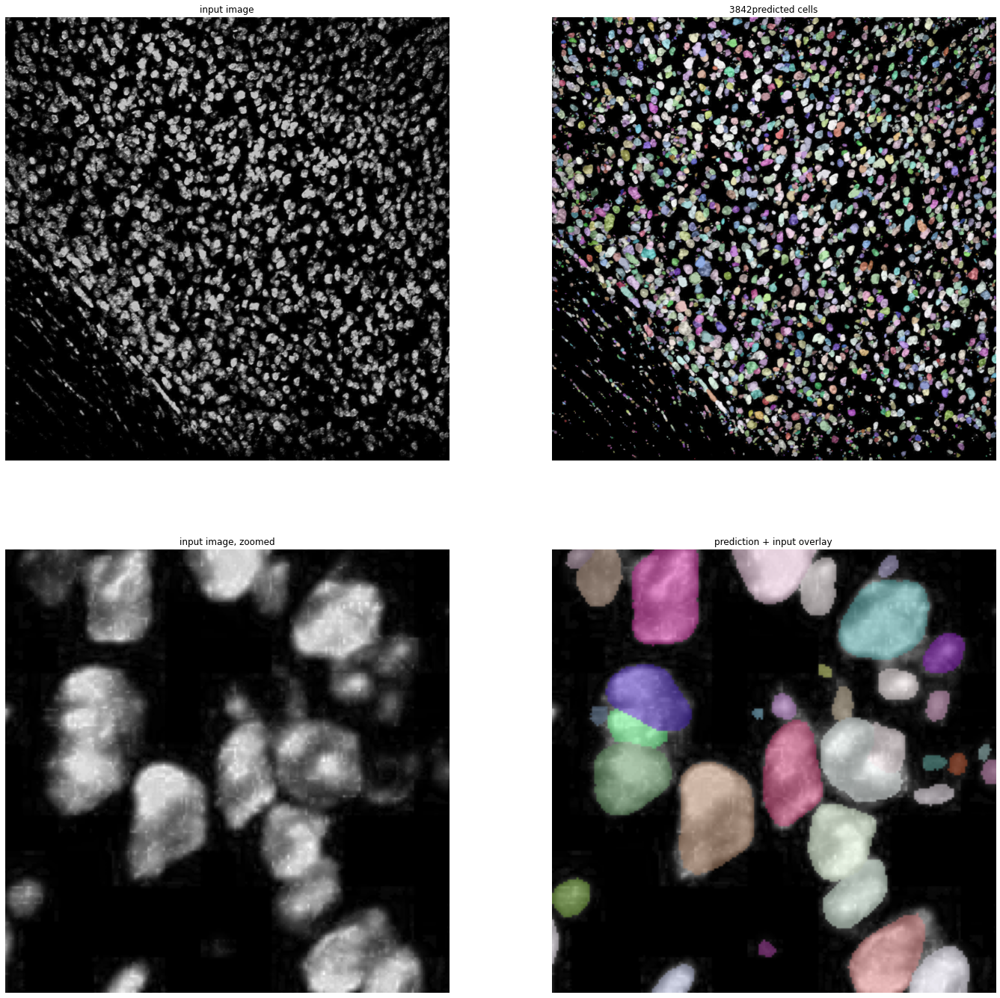

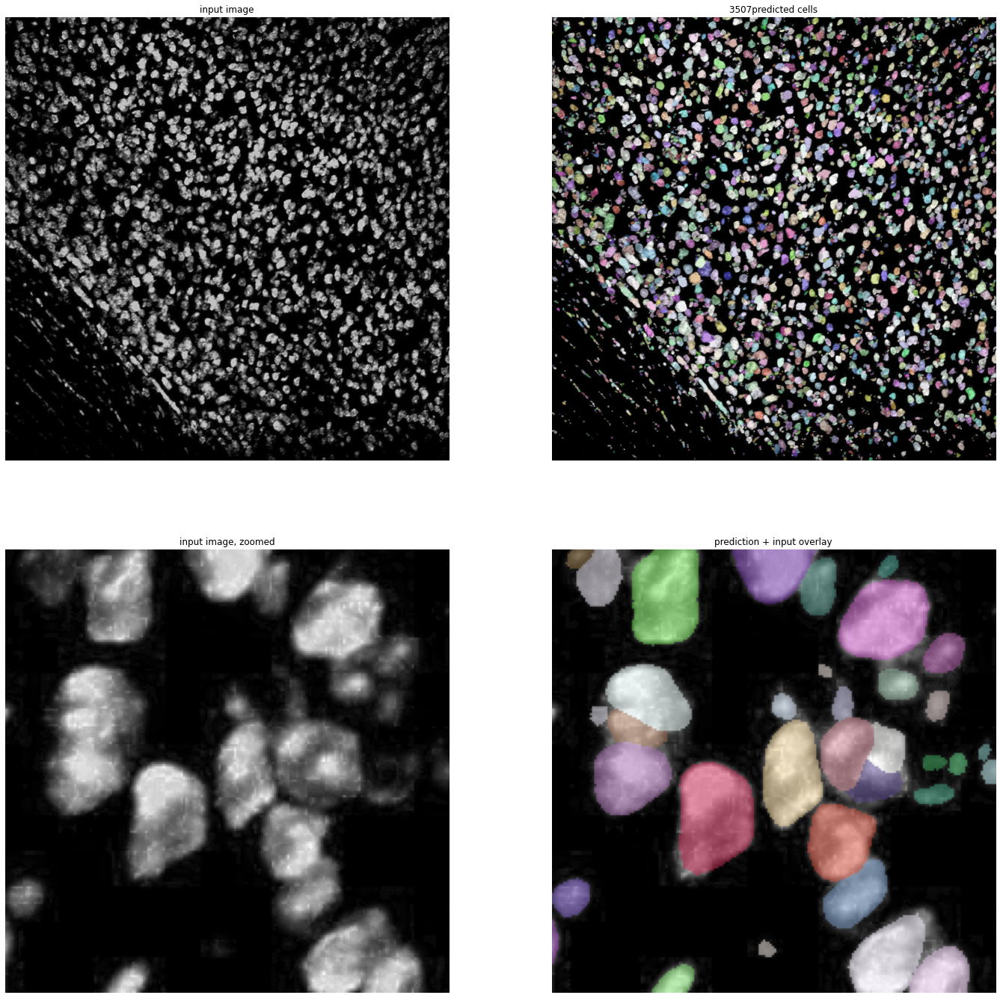

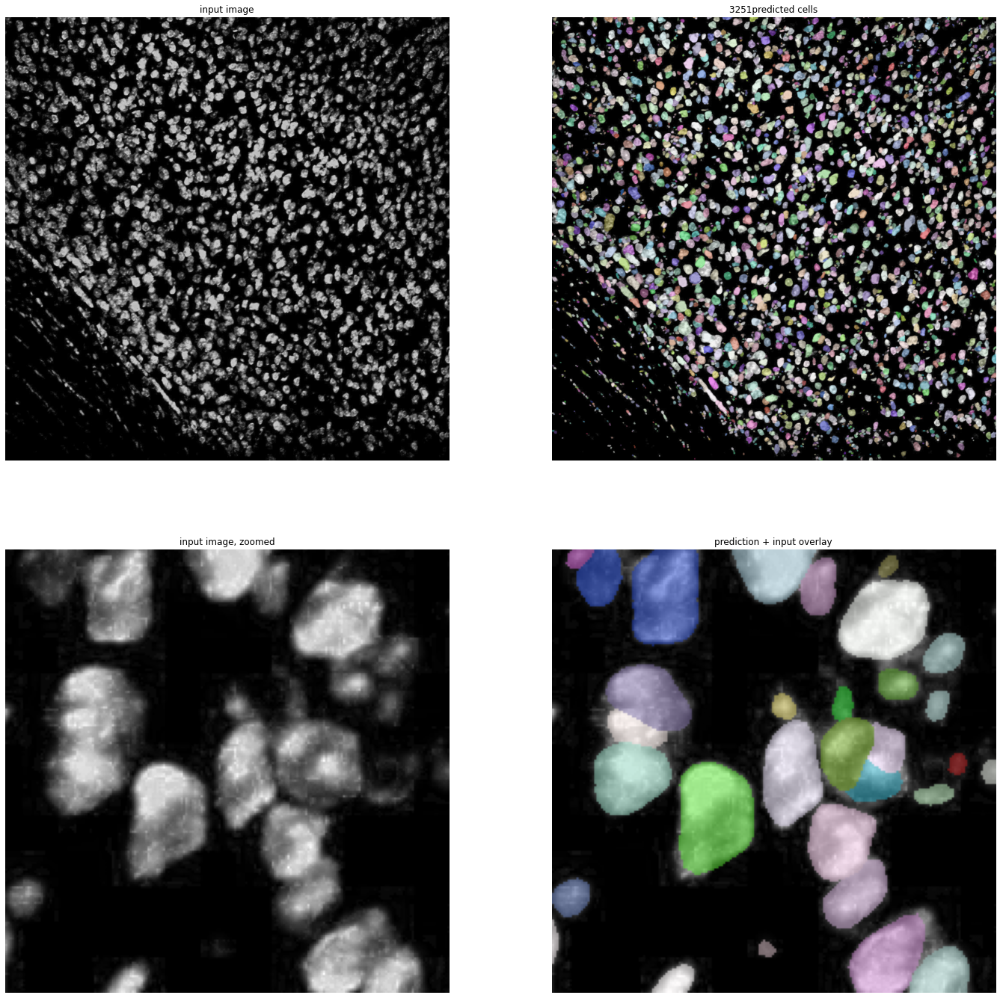

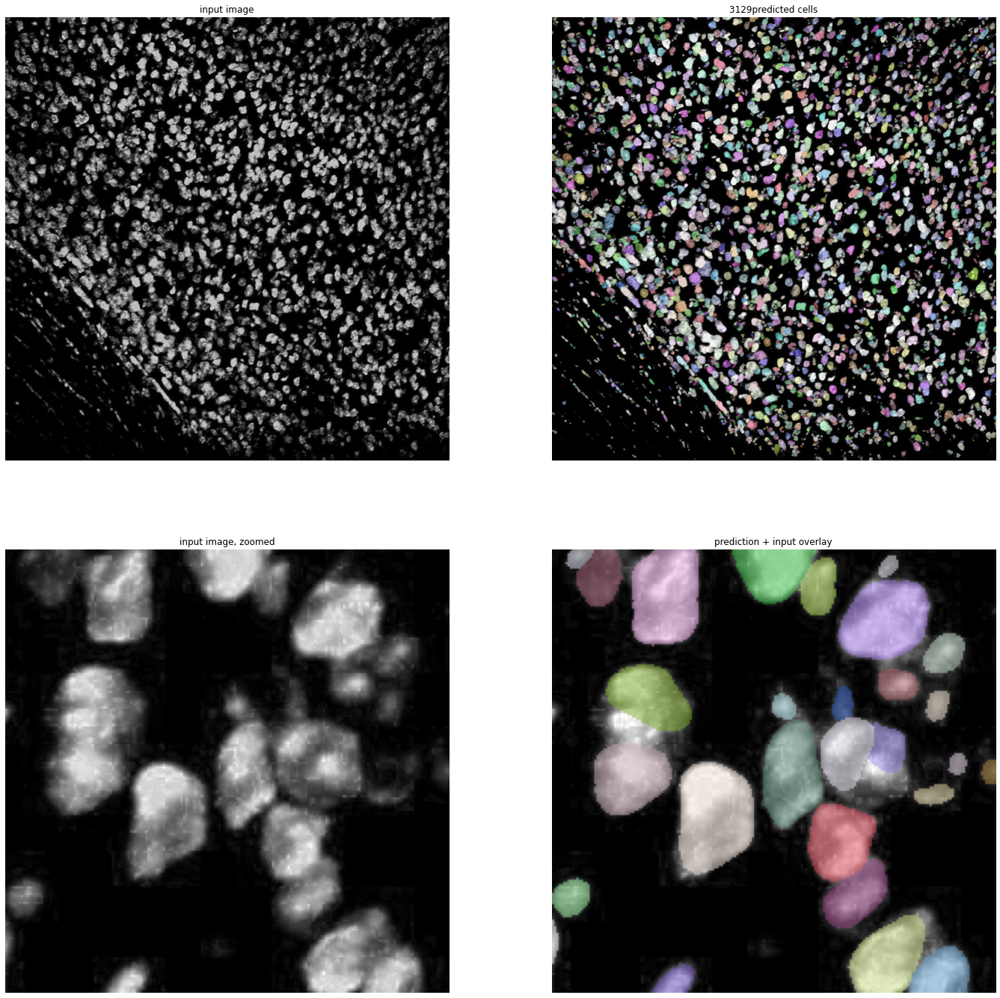

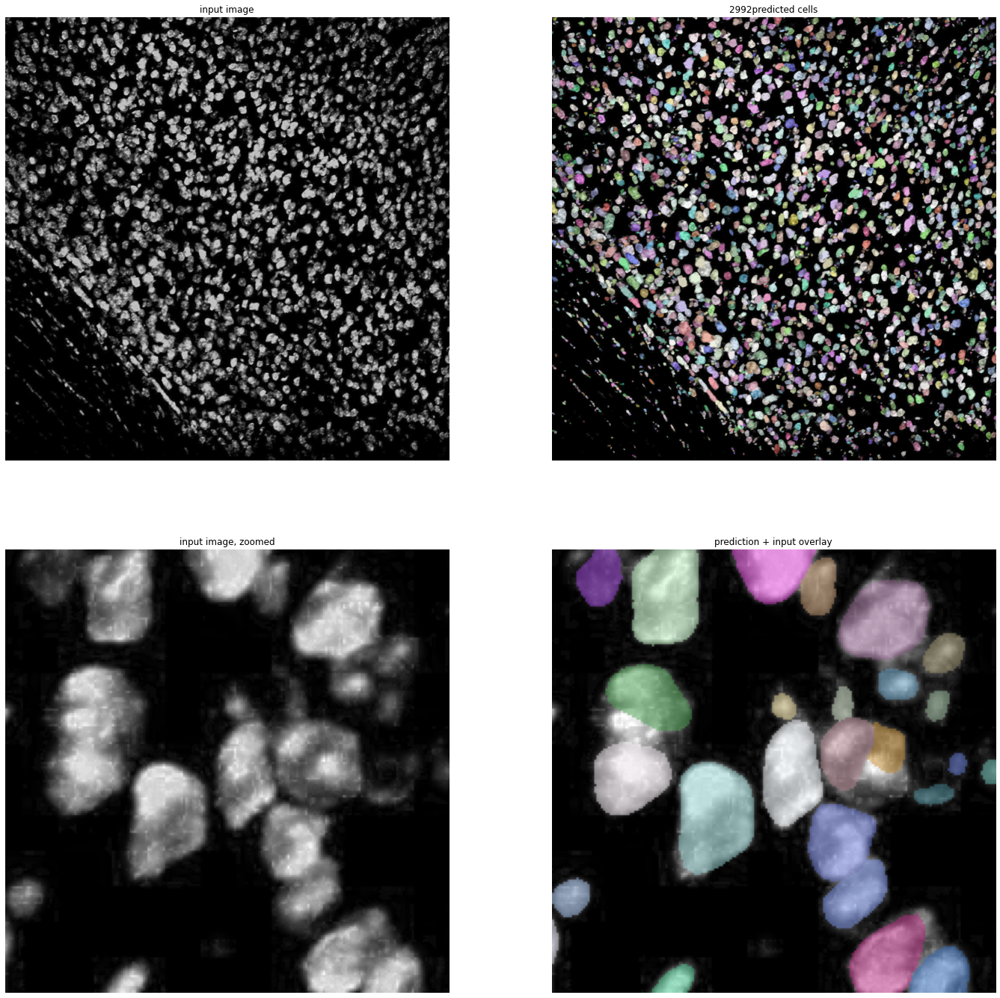

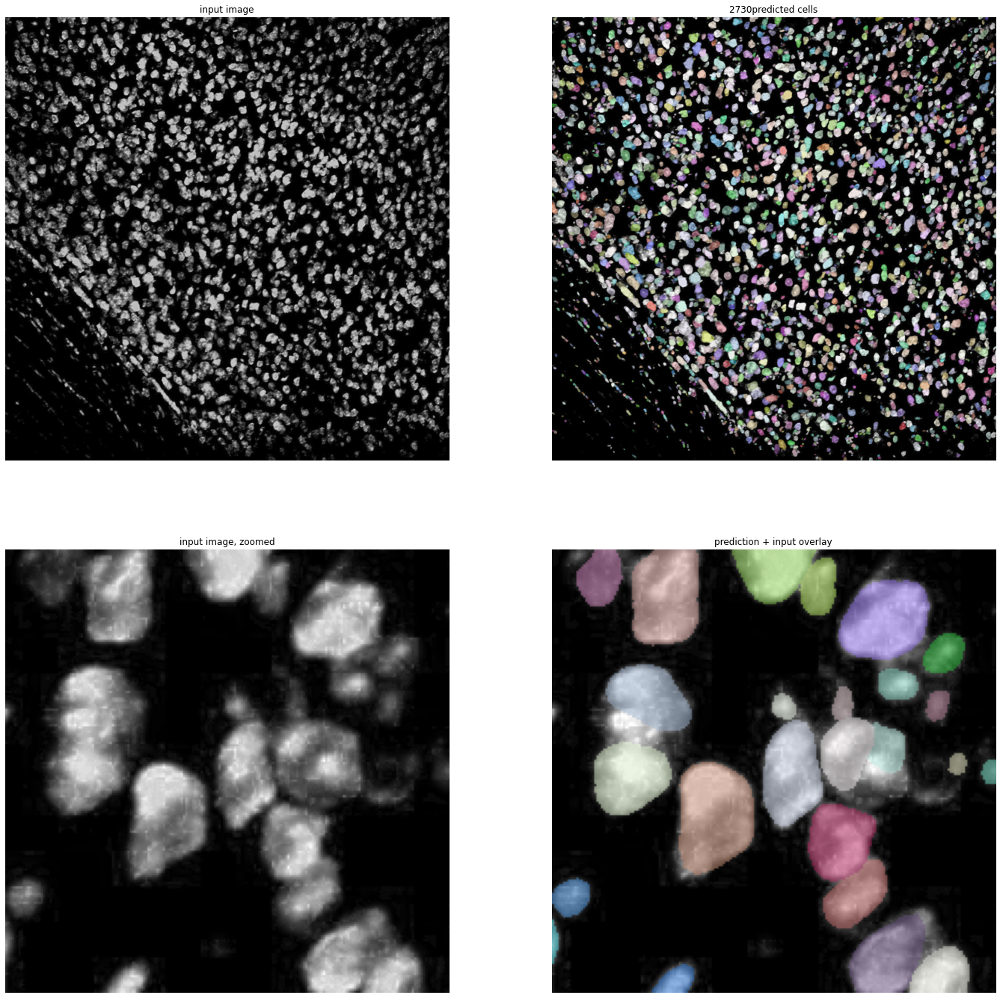

In [13]:
prob_threshes = [0.1, 0.2, 0.3, 0.35, 0.4, 0.5]
for pt in prob_threshes:
    labels, details = model.predict_instances(normalize(img_gray), prob_thresh=pt)
    zoom_area = [1000, 1000, 1200, 1200]
    fig = plot_pred_overlay(img_gray, labels, zoom=zoom_area)
    figname = './results/nissl'
    for c in zoom_area:
        figname += str(c) + '_'
    figname += 'pt' + str(round(pt*100)) + '.png'
    fig.savefig(figname, dpi=600)

In [14]:
# default prob_tresh: 0.479071
# default nms_thresh: 0.3

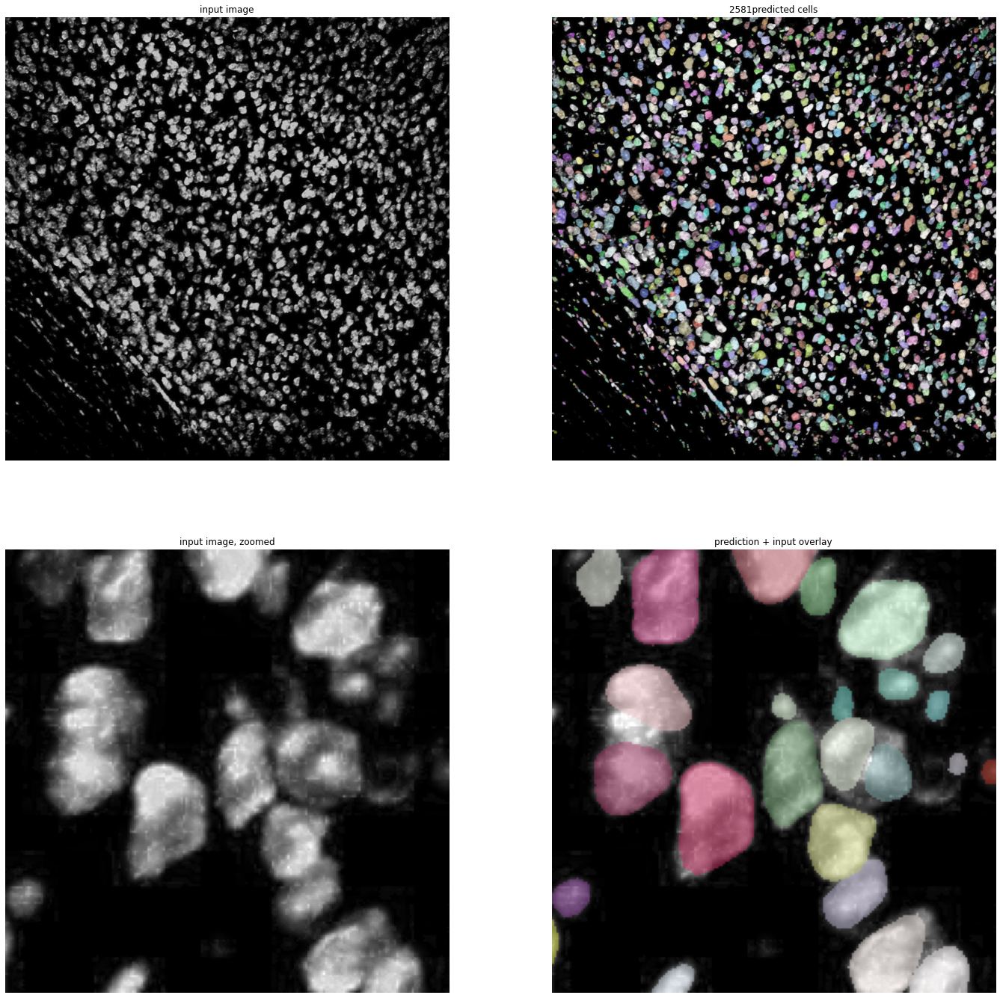

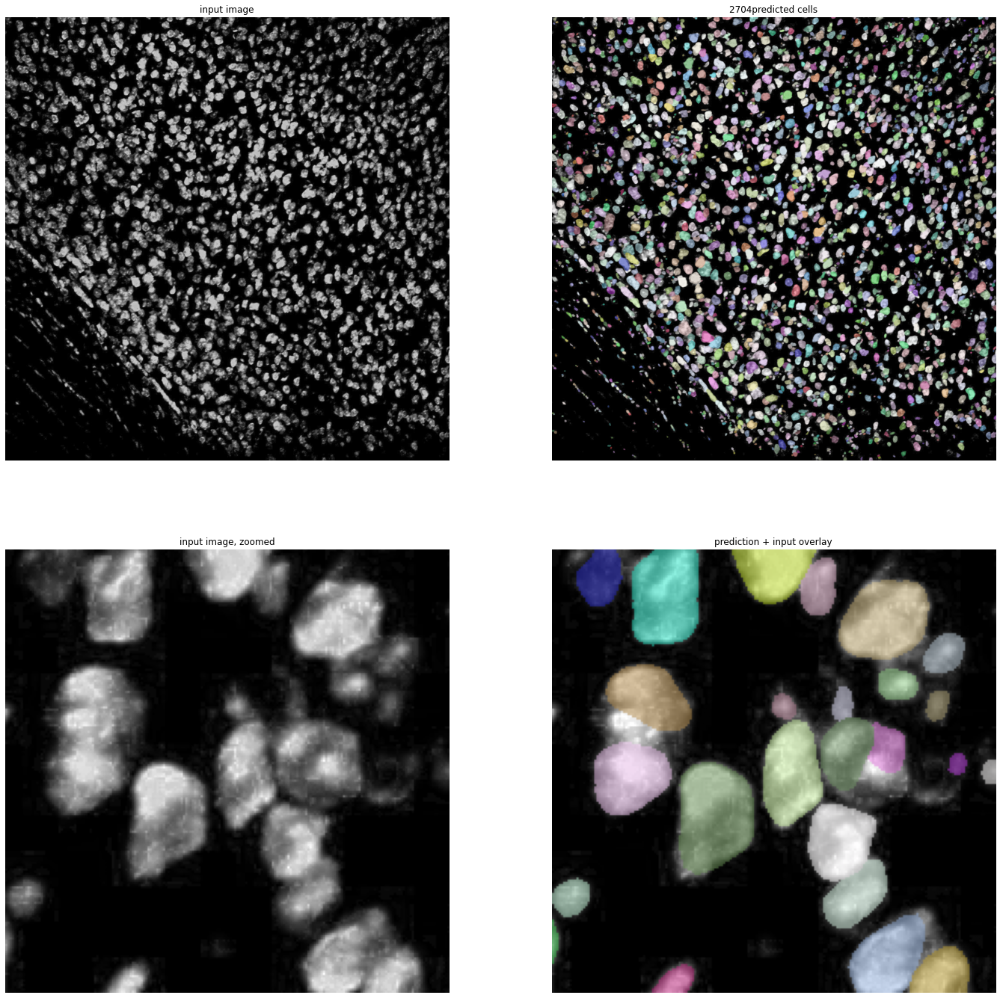

KeyboardInterrupt: 

In [15]:
nms_threshes = [0.1, 0.2, 0.3, 0.35, 0.4, 0.5]
for nms in nms_threshes:
    labels, details = model.predict_instances(normalize(img_gray), nms_thresh=nms)
    zoom_area = [1000, 1000, 1200, 1200]
    fig = plot_pred_overlay(img_gray, labels, zoom=zoom_area)
    figname = './results/nissl'
    for c in zoom_area:
        figname += str(c) + '_'
    figname += 'nms' + str(round(nms*100)) + '.png'
    fig.savefig(figname, dpi=600)

nms: It seems like when we go from nms = 0.35 to nms = 0.3, that we loose some big cells! I think it might be a good idea to increase nms a little bit from default. -0.35

A little bit of ground truth would be extemely helpful here!

When it comes to probability threshold, it seems like we can lower this a bit, to get more of the overlapping cells. 0.4 seems reasonable, but again this should be tested with ground truth data.

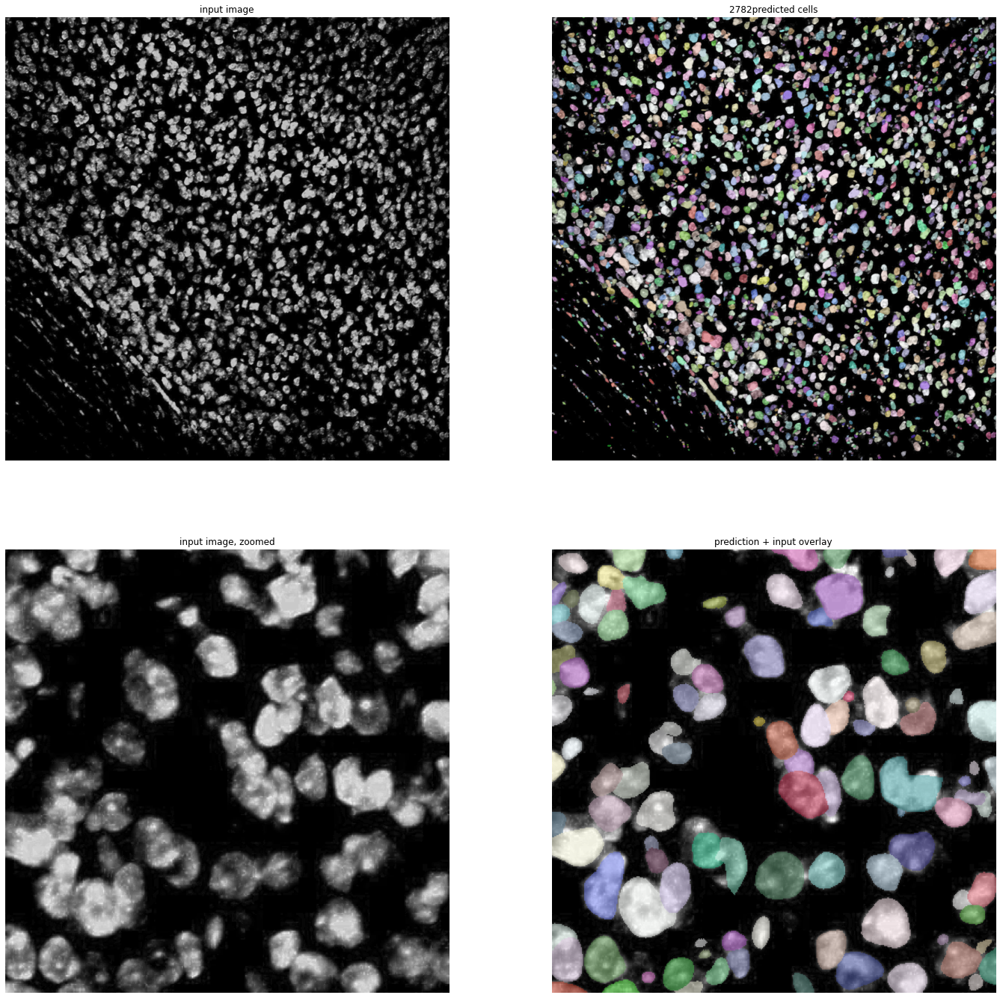

In [247]:
nms = 0.35
pt = 0.5

labels, details = model.predict_instances(normalize(img_gray), 
                                          prob_thresh=pt,
                                          nms_thresh=nms)
zoom_area = [600,600, 1000, 1000]
fig = plot_pred_overlay(img_gray, labels, zoom=zoom_area)
figname = './results/nissl_pt'+ str(round(pt*100)) +'_nms_' + str(round(nms*100)) + '.png'
fig.savefig(figname, dpi=600)